In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
import os
path = '/content/drive/My Drive/kaggle/wheat/'
os.chdir(path) # カレントディレクトリを指定
os.getcwd()

'/content/drive/My Drive/kaggle/wheat'

In [ ]:
!!pip install kaggle

['Requirement already satisfied: kaggle in /usr/local/lib/python3.6/dist-packages (1.5.6)',
 'Requirement already satisfied: python-dateutil in /usr/local/lib/python3.6/dist-packages (from kaggle) (2.8.1)',
 'Requirement already satisfied: tqdm in /usr/local/lib/python3.6/dist-packages (from kaggle) (4.41.1)',
 'Requirement already satisfied: requests in /usr/local/lib/python3.6/dist-packages (from kaggle) (2.23.0)',
 'Requirement already satisfied: urllib3<1.25,>=1.21.1 in /usr/local/lib/python3.6/dist-packages (from kaggle) (1.24.3)',
 'Requirement already satisfied: certifi in /usr/local/lib/python3.6/dist-packages (from kaggle) (2020.6.20)',
 'Requirement already satisfied: python-slugify in /usr/local/lib/python3.6/dist-packages (from kaggle) (4.0.0)',
 'Requirement already satisfied: six>=1.10 in /usr/local/lib/python3.6/dist-packages (from kaggle) (1.12.0)',
 'Requirement already satisfied: chardet<4,>=3.0.2 in /usr/local/lib/python3.6/dist-packages (from requests->kaggle) (3.0.

In [ ]:
!mkdir -p /root/.kaggle/
!cp /content/drive/"My Drive"/kaggle/config/kaggle.json /root/.kaggle/kaggle.json

In [ ]:
import os
from kaggle.api.kaggle_api_extended import KaggleApi
api = KaggleApi()
api.authenticate()
# competitions = api.competitions_list(category="featured")
# for comp in competitions:
#     print(comp.ref,comp.reward,comp.userRank,sep=',')

In [ ]:
import re
competitions = 'global-wheat-detection'

for json_dict in api.competitions_data_list_files(competitions):
  data_path = './input'
  name = json_dict['name']
  match = re.search(r'.*/', name)
  if match is not None:
    data_path = os.path.join(data_path, match.group())
  api.competition_download_file(competitions, name, data_path)

In [ ]:
import glob
import zipfile

def unzip(path):
  zip_files = glob.glob(f"{path}/**/*.zip")
  for file in zip_files:
    print(file)
    with zipfile.ZipFile(file) as existing_zip:
        existing_zip.extractall(path=os.path.dirname(file))

unzip(path)

/content/drive/My Drive/kaggle/wheat/input/train.csv.zip


In [ ]:
!pip install albumentations -U

     |████████████████████████████████| 122kB 2.7MB/s 
     |████████████████████████████████| 952kB 8.7MB/s 
  Created wheel for albumentations: filename=albumentations-0.4.6-cp36-none-any.whl size=65164 sha256=9802dce1227b25b5ea5f83a83c626610d2c1ac7222c493eead4c14a00f302d6f
  Stored in directory: /root/.cache/pip/wheels/c7/f4/89/56d1bee5c421c36c1a951eeb4adcc32fbb82f5344c086efa14
Successfully built albumentations
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: albumentations 0.1.12
    Uninstalling albumentations-0.1.12:
      Successfully uninstalled albumentations-0.1.12


# Code

In [ ]:
import numpy as np
import pandas as pd
import os
from tqdm.auto import tqdm
import shutil as sh
from sklearn.model_selection import KFold
import matplotlib.pyplot as plt
from PIL import Image
import matplotlib.patches as patches

DATA_DIR = './input'

In [ ]:
df = pd.read_csv(os.path.join(DATA_DIR, 'psuedo_label.csv'), index_col=0)

df = df[~df.index.isin([35, 142, 170, 216, 215])]
append_df = pd.DataFrame({'image_id': ['796707dd7', '796707dd7', '796707dd7', '796707dd7', 'aac893a91', 'aac893a91', '51b3e36ab', '53f253011', '2fd875eaa', '2fd875eaa'],
                          'x': [0, 0, 100, 150, 490, 830, 974, 1000, 165, 242],
                          'y': [770, 830, 910, 990, 988, 552, 736, 512, 1000, 1000], 
                          'w': [50, 50, 70, 100, 68, 60, 49, 24, 60, 60],
                          'h': [55, 120, 90, 34, 36, 80, 210, 50, 24, 24]})
df = pd.concat([df, append_df]).reset_index(drop=True)
df.head()

,image_id,x,y,w,h
0,348a992bb,734,224,139,83
1,348a992bb,140,40,113,86
2,348a992bb,539,33,77,95
3,348a992bb,598,445,119,95
4,348a992bb,3,473,133,91


In [ ]:
image_id = '51b3e36ab'
df[df.image_id==image_id][df.x > 900]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


,image_id,x,y,w,h
272,51b3e36ab,974,736,49,210


348a992bb


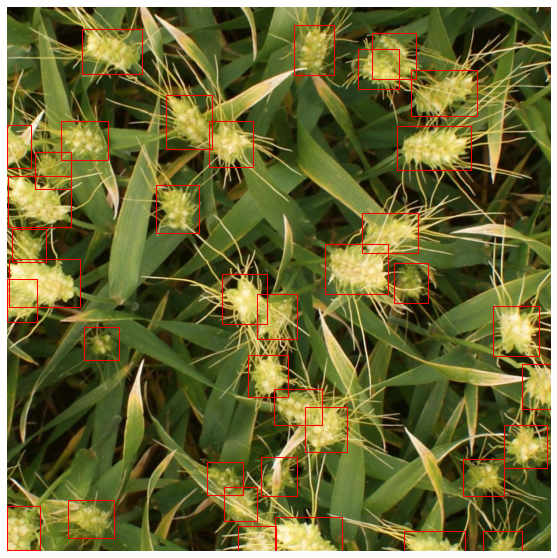

796707dd7


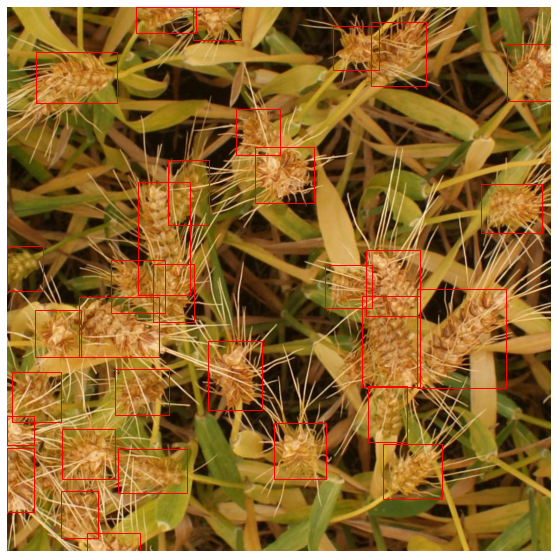

aac893a91


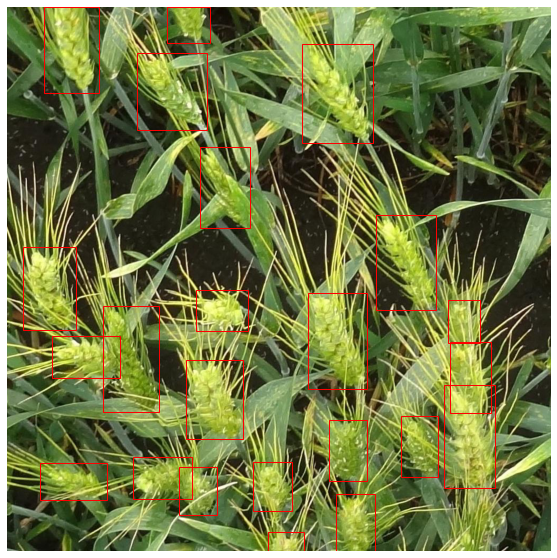

f5a1f0358


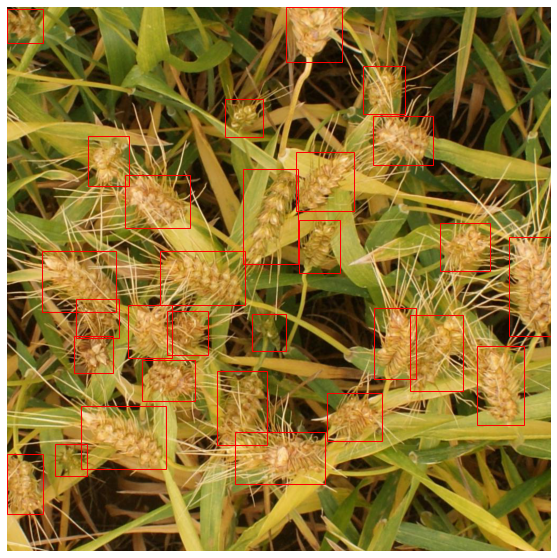

cb8d261a3


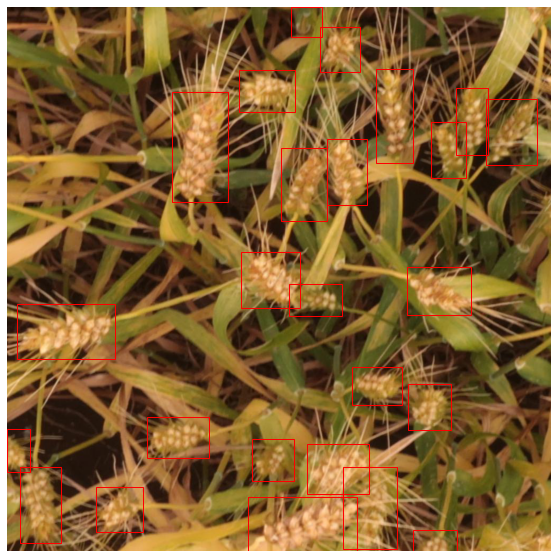

cc3532ff6


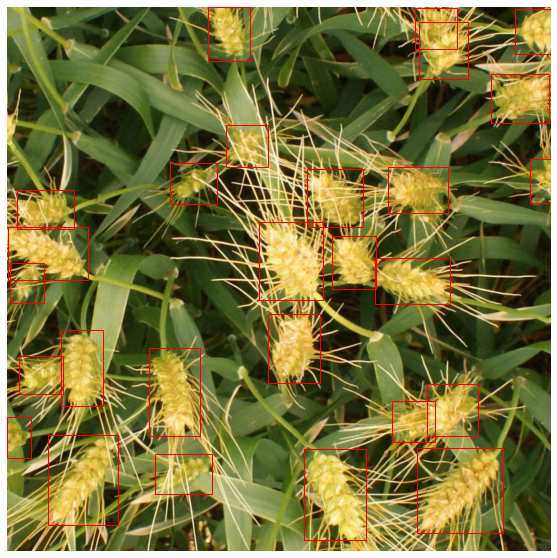

51f1be19e


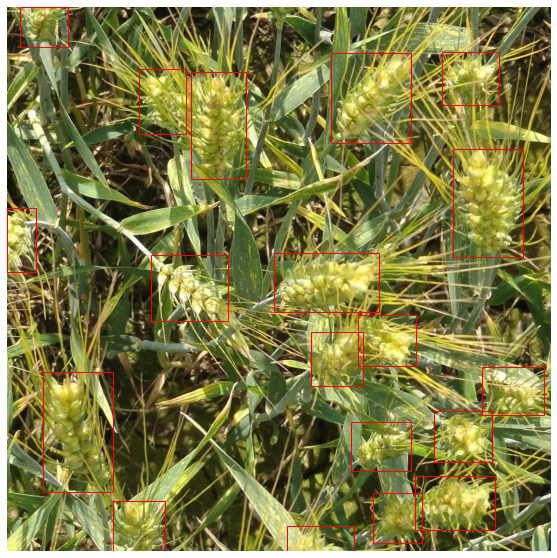

51b3e36ab


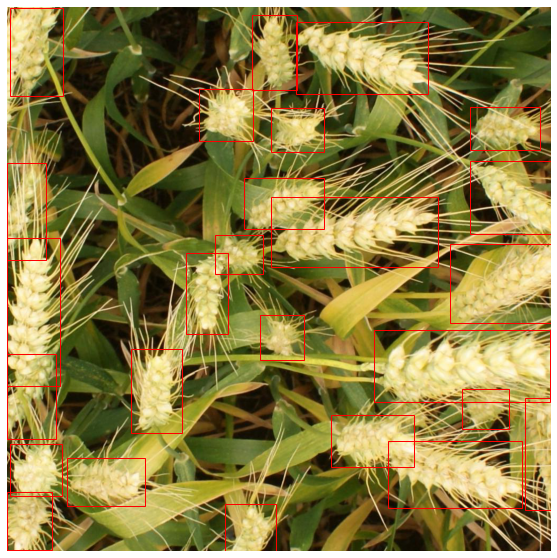

53f253011


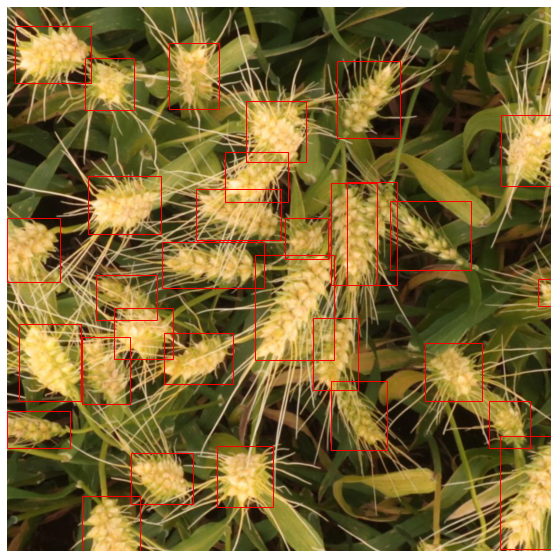

2fd875eaa


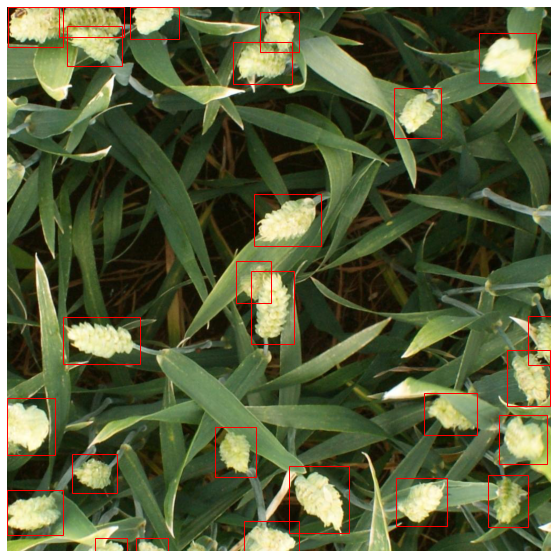

In [ ]:
plot_image_examples(df, 'input/test', 10)

In [ ]:
df.to_csv(os.path.join(DATA_DIR, 'psuedo_label_mod.csv'))

348a992bb


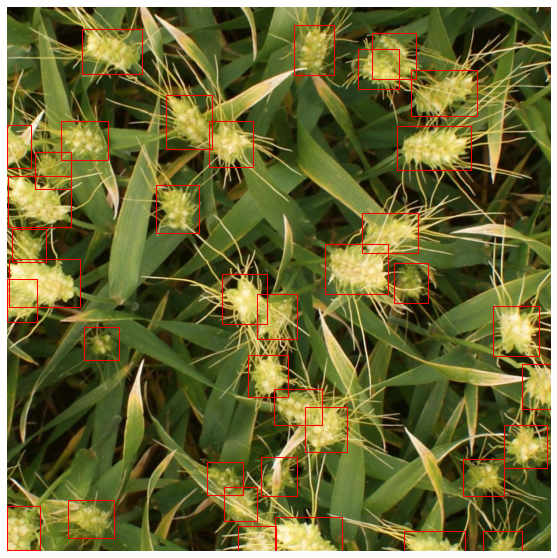

796707dd7


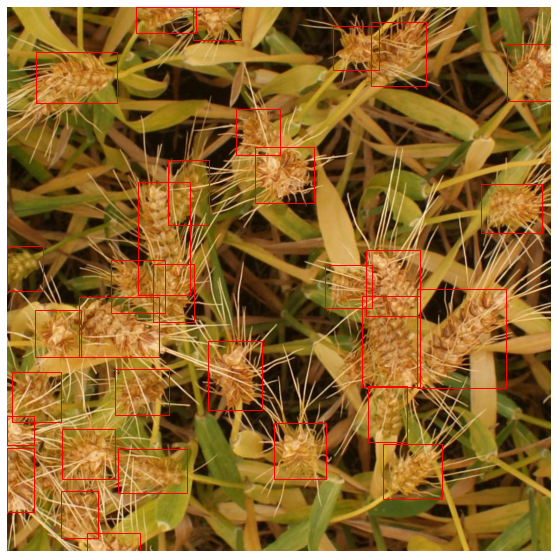

aac893a91


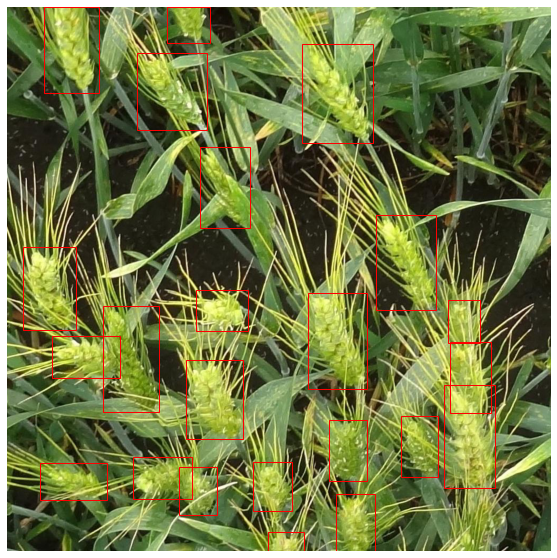

f5a1f0358


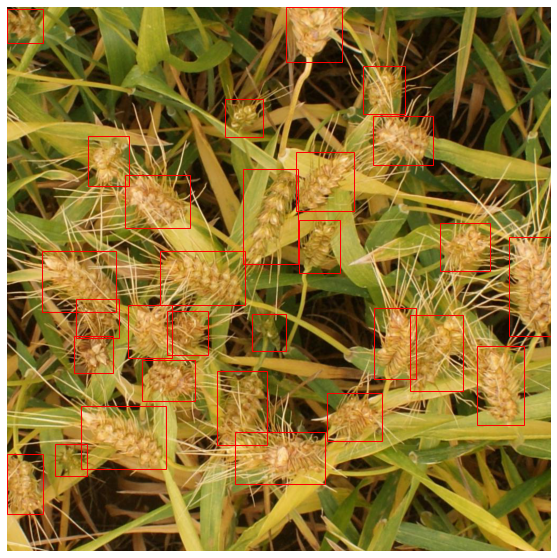

cb8d261a3


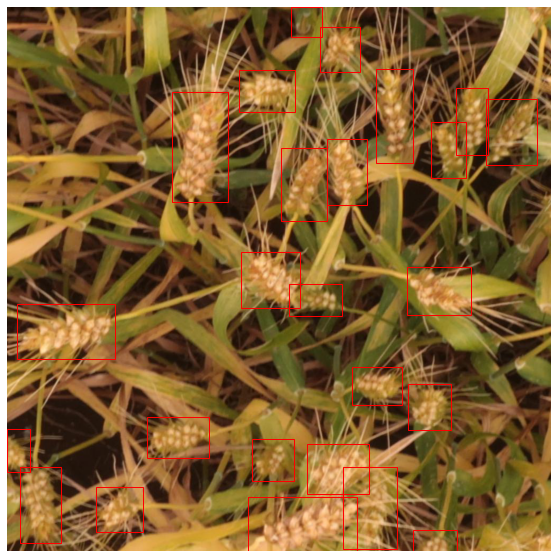

cc3532ff6


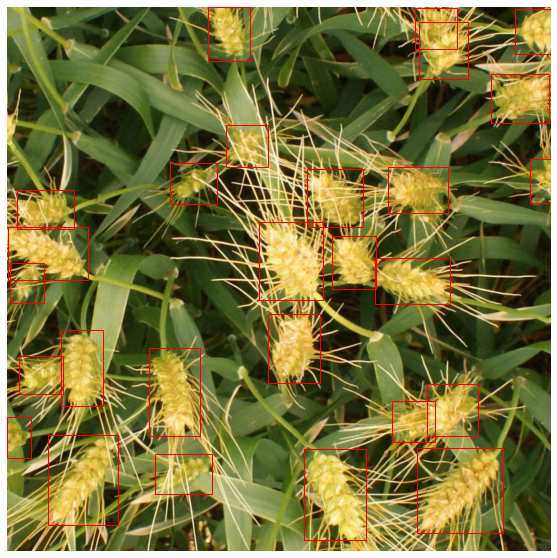

51f1be19e


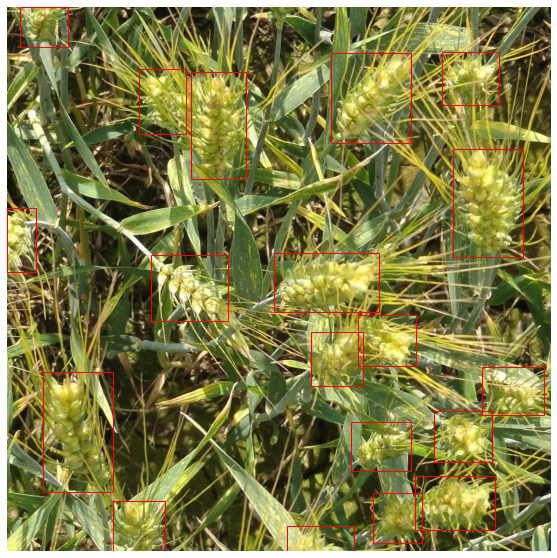

51b3e36ab


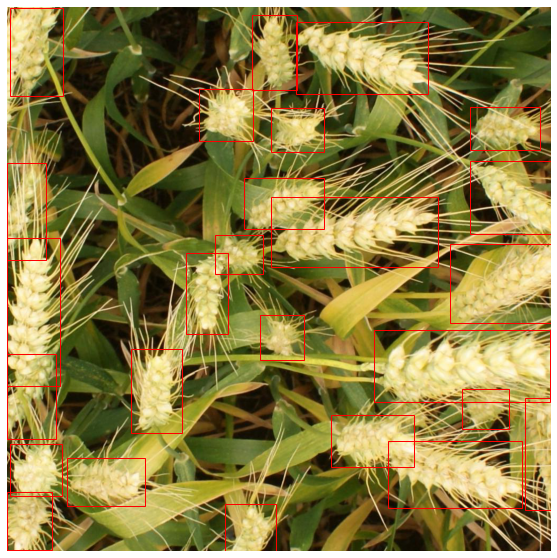

53f253011


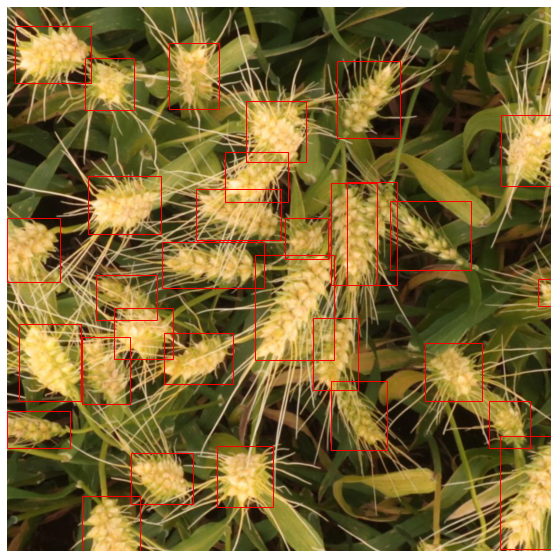

2fd875eaa


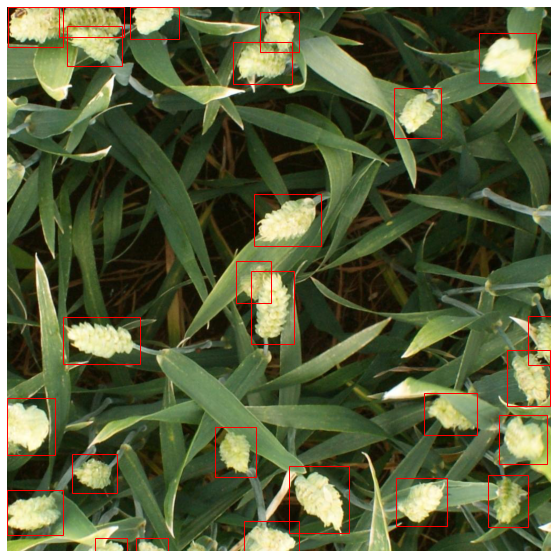

In [ ]:
def get_all_bboxes(df, image_id):
    image_bboxes = df[df.image_id == image_id]
    
    bboxes = []
    for _,row in image_bboxes.iterrows():
        bboxes.append((row.x, row.y, row.w, row.h))
        
    return bboxes

def plot_image_examples(df, path, n=9, title='Image examples'):
    img_ids = list(df.image_id.unique())
    for row in range(n):
        fig, axs = plt.subplots(figsize=(10,10))
        img_id = img_ids[row]
        print(img_id)
        
        img = Image.open(os.path.join(path, img_id + '.jpg'))
        axs.imshow(img)
        
        bboxes = get_all_bboxes(df, img_id)
        
        for bbox in bboxes:
            rect = patches.Rectangle((bbox[0],bbox[1]),bbox[2],bbox[3],linewidth=1,edgecolor='r',facecolor='none')
            axs.add_patch(rect)
        
        axs.axis('off')
        plt.show()

plot_image_examples(df, 'input/test', 10)

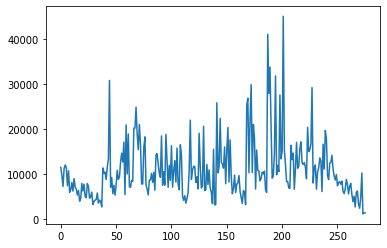

In [ ]:
df['area'] = df['w'] * df['h']
plt.plot(df.area)
plt.show()

image_ids = df[df.area>100000].image_id
# image_ids = ['41c0123cc', '69fc3d3ff', '2cc75e9f5', '409a8490c', 'd067ac2b1']
tmp = df[df.image_id.isin(image_ids)]
tmp = tmp.reset_index(drop=True)
plot_image_examples(tmp, 'input/train', len(tmp.image_id.unique()))

# Augmented Image

In [ ]:
# https://github.com/albumentations-team/albumentations_examples/blob/master/notebooks/showcase.ipynb

import os

import numpy as np
import cv2
from matplotlib import pyplot as plt
from skimage.color import label2rgb

import albumentations as A
import random

def augment_and_show(aug, images, mask=None, bboxes=[], categories=[], category_id_to_name=[], filename=None, 
                     font_scale_orig=0.35, 
                     font_scale_aug=0.35, show_title=True, **kwargs):
    for image_path in images:
      image = cv2.imread(image_path)
      augmented = aug(image=image, mask=mask, bboxes=bboxes, category_id=categories)

      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      image_aug = cv2.cvtColor(augmented['image'], cv2.COLOR_BGR2RGB)

      f, ax = plt.subplots(1, 2, figsize=(8, 6))
      ax[0].axis('off')
      ax[1].axis('off')
      
      ax[0].imshow(image)
      ax[0].set_title('Original image')
      
      ax[1].imshow(image_aug)
      ax[1].set_title('Augmented image')

      f.tight_layout()

In [ ]:
random.seed(42)
images_path = os.listdir(os.path.join(DATA_DIR, 'train'))
samples = random.sample(images_path, 3)
samples = [os.path.join(DATA_DIR, 'train', sample) for sample in samples]

print(samples)

['./input/train/4e9096ca9.jpg', './input/train/d9b373de2.jpg', './input/train/b745b9e4d.jpg']


In [ ]:
# http://rikeiin.hatenablog.com/entry/2019/09/17/125945
# kaggle.com/c/aptos2019-blindness-detection/discussion/107926#620807
# https://www.kaggle.com/c/aptos2019-blindness-detection/discussion/107987#621164

# めちゃいい: https://github.com/Kazuhito00/albumentations-examples/blob/master/albumentations-examples.ipynb
shift = A.Compose([   
    A.ShiftScaleRotate(shift_limit=0, scale_limit=0.75, rotate_limit=0, border_mode=0, value=(1, 1, 1), p=1.0)
], p=1)

pad = A.Compose([   
    A.PadIfNeeded(min_height=2048, min_width=2048, border_mode=1, p=1.0)
], p=1)

scale = A.Compose([   
    A.RandomScale(scale_limit=3.0, p=1.0)
], p=1)

blur = A.Compose([   
    A.Blur(blur_limit=30, p=1.0)
], p=1)

rotate = A.Compose([   
    A.RandomRotate90(p=1.0)
], p=1)

gamma = A.Compose([   
    A.RandomGamma(p=1)
], p=1)

clahe = A.Compose([  
    A.CLAHE(p=1),
], p=1)

norm = A.Compose([  
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), max_pixel_value=255.0, p=1.0)
], p=1)

contrast = A.Compose([
    A.RandomContrast(limit=0.2, p=1.0)
], p=1)

gaus_noise = A.Compose([
    A.GaussNoise(var_limit=(10.0, 100.0), mean=0, p=1.0)
], p=1)

snow = A.Compose([
    A.RandomSnow(snow_point_lower=0.1, snow_point_upper=0.5, brightness_coeff=2.5, p=1.0)
], p=1)

rain = A.Compose([
    A.RandomRain(slant_lower=-10, slant_upper=10, drop_length=20, drop_width=3, drop_color=(200, 200, 200), blur_value=7, brightness_coefficient=0.7, rain_type=None, p=1.0)
], p=1)

fog = A.Compose([
    A.RandomFog(fog_coef_lower=0.3, fog_coef_upper=1, alpha_coef=0.08, p=1.0)
], p=1)

sun = A.Compose([
    A.RandomSunFlare(flare_roi=(0, 0, 1, 0.5), angle_lower=0, angle_upper=1, num_flare_circles_lower=6, num_flare_circles_upper=10, src_radius=40, src_color=(255, 255, 255), p=1.0)
], p=1)

grid_dropout = A.Compose([
    A.GridDropout(ratio = 0.5, unit_size_min = None, unit_size_max = None, holes_number_x = None, holes_number_y = None, shift_x = 0, shift_y = 0, random_offset = False, fill_value = 0, mask_fill_value = None, p=1.0)
], p=1)

light = A.Compose([
    A.RandomBrightnessContrast(brightness_limit=0.5, contrast_limit=0.5, p=1),    
    A.RandomGamma(p=1),    
    A.CLAHE(p=1), # http://labs.eecs.tottori-u.ac.jp/sd/Member/oyamada/OpenCV/html/py_tutorials/py_imgproc/py_histograms/py_histogram_equalization/py_histogram_equalization.html
], p=1)

medium = A.Compose([
    A.CLAHE(p=1),
    A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=50, val_shift_limit=50, p=1),
], p=1)

strong = A.Compose([
    A.ChannelShuffle(p=1),
], p=1)

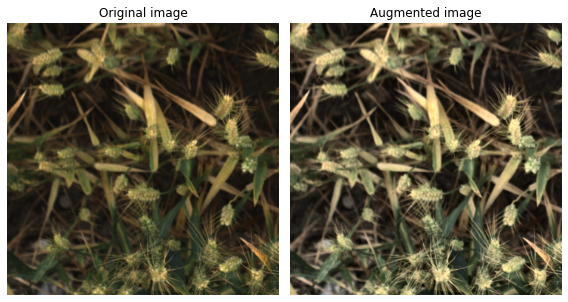

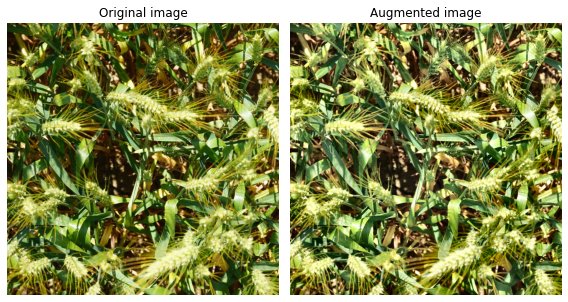

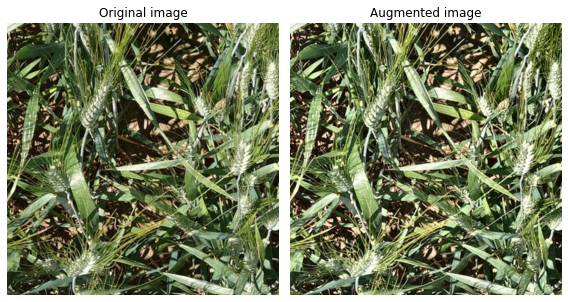

In [ ]:
augment_and_show(clahe, samples)

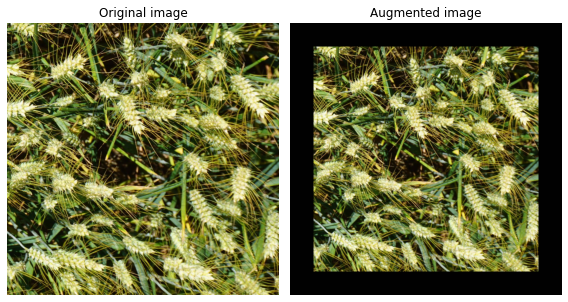

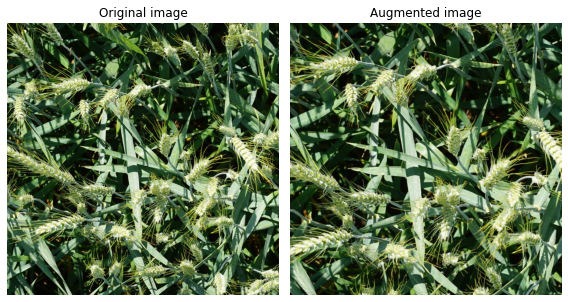

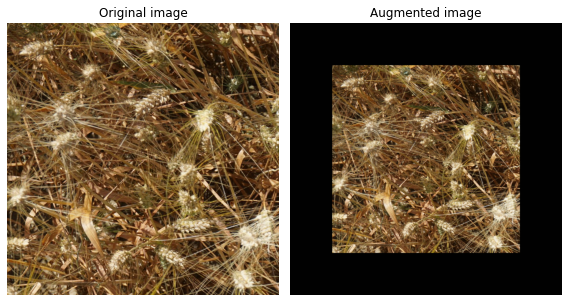

In [ ]:
augment_and_show(shift, samples)

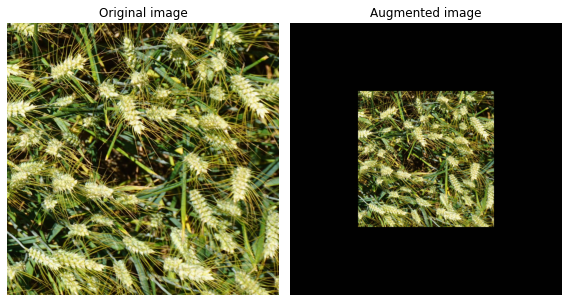

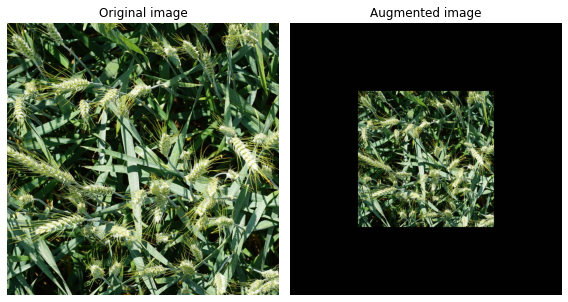

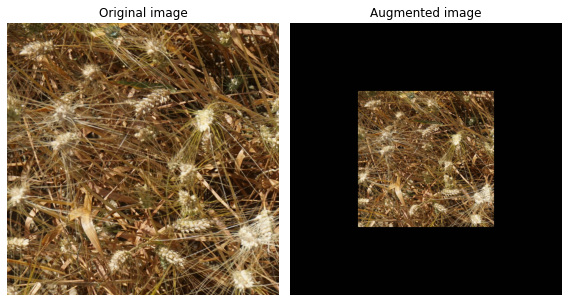

In [ ]:
pad = A.Compose([
    A.Resize(height=512, width=512, p=1),
    A.PadIfNeeded(min_height=1024, min_width=1024, border_mode=0, value=(1, 1, 1), p=1.0)
], p=1)

augment_and_show(pad, samples)

In [ ]:
augment_and_show(grid_dropout, samples) # 微妙そうだが試す価値はありか？

In [ ]:
augment_and_show(sun, samples) # 微妙そうだけど試す価値はあるか？

In [ ]:
augment_and_show(fog, samples) # ありそう

In [ ]:
augment_and_show(rain, samples) # 試してみたい

In [ ]:
augment_and_show(snow, samples)

In [ ]:
augment_and_show(gaus_noise, samples)

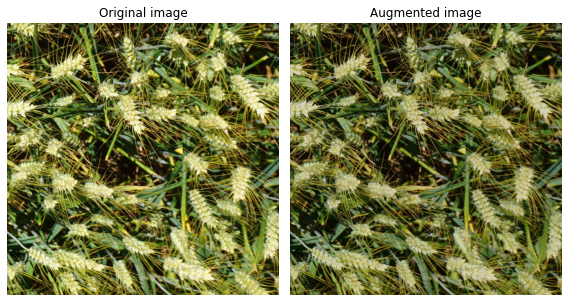

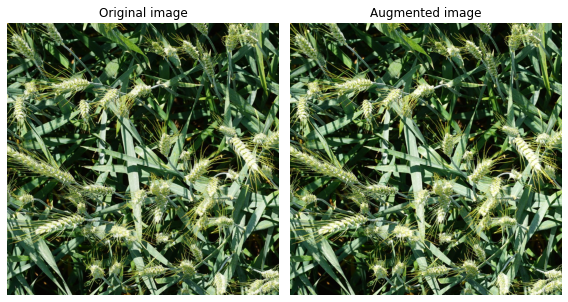

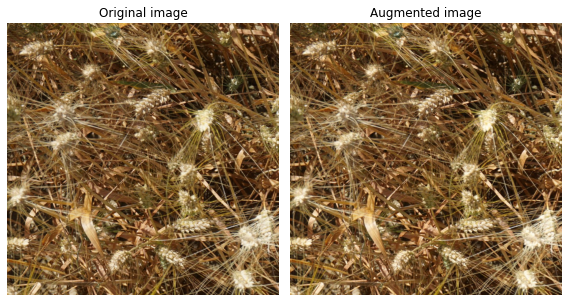

In [ ]:
augment_and_show(contrast, samples)

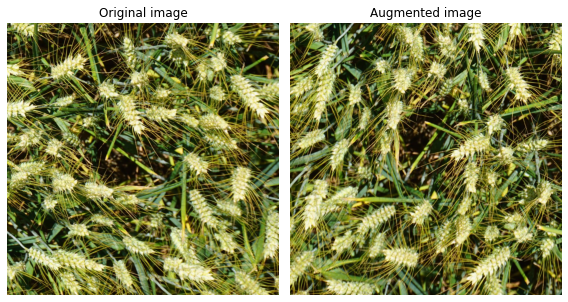

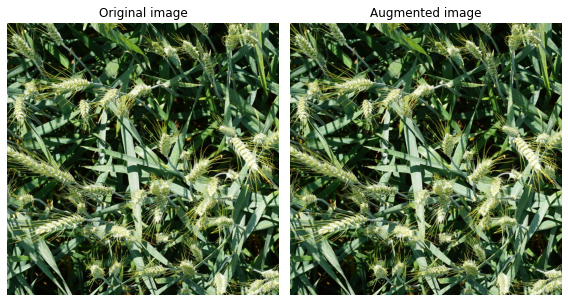

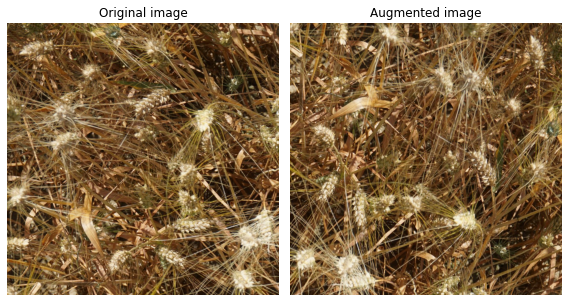

In [ ]:
augment_and_show(rotate, samples) # あり

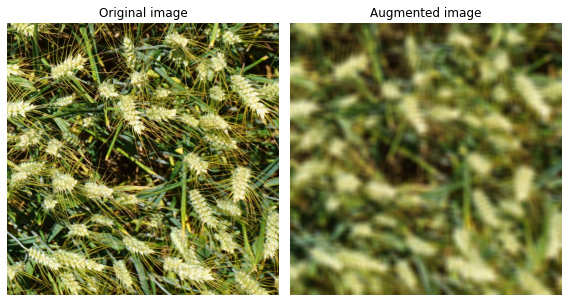

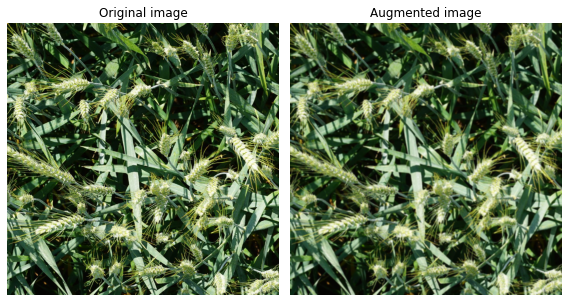

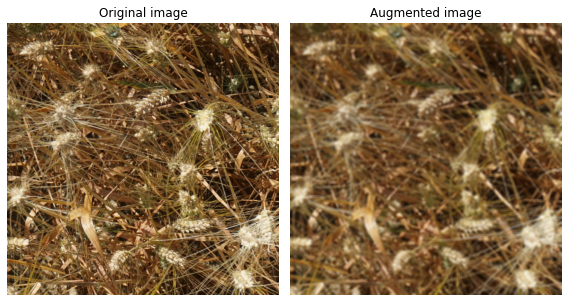

In [ ]:
augment_and_show(blur, samples) # あり

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


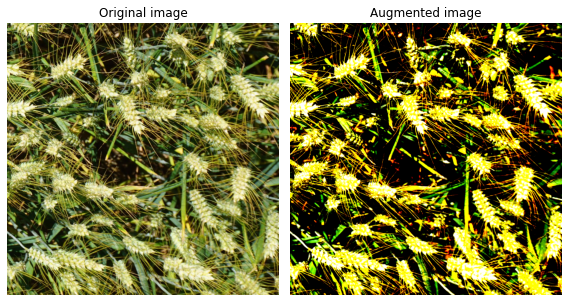

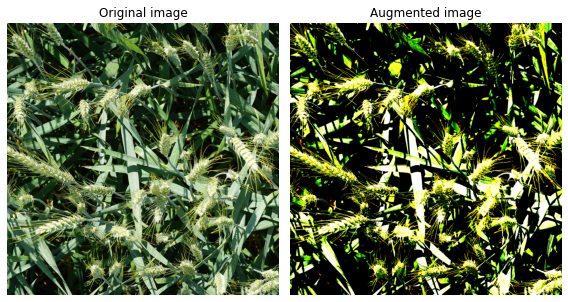

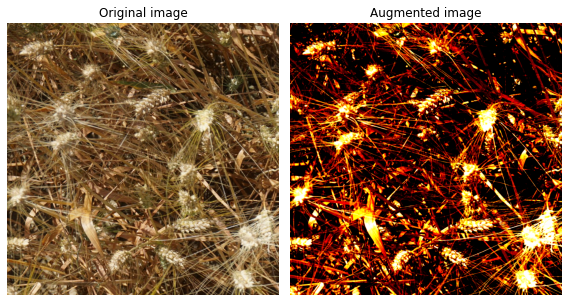

In [ ]:
augment_and_show(norm, samples) # 微妙だけどありか？　train, val両方に適用させてみる？

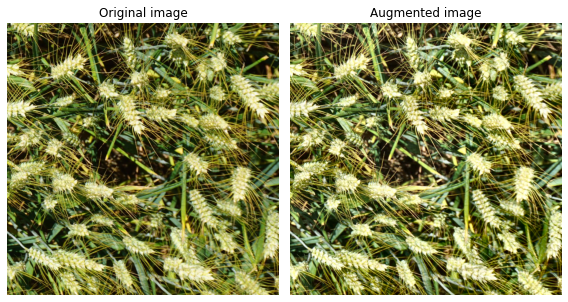

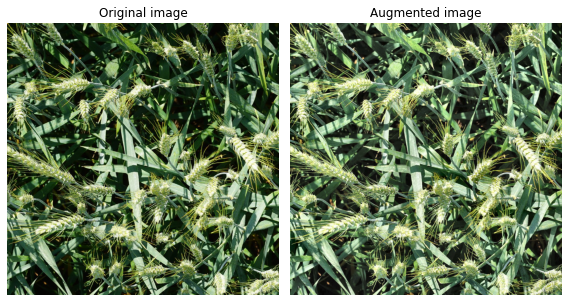

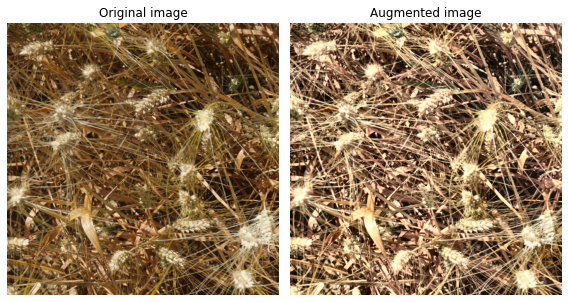

In [ ]:
augment_and_show(gamma, samples)

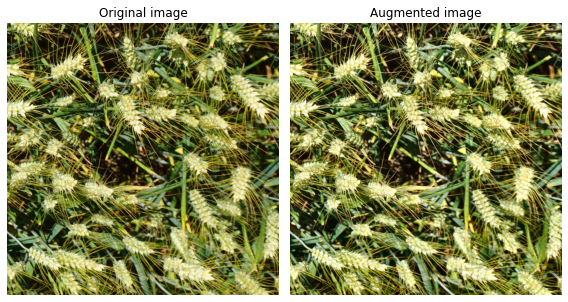

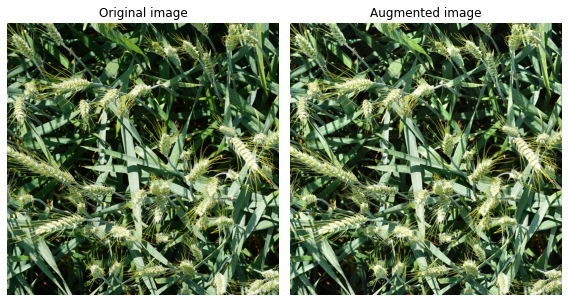

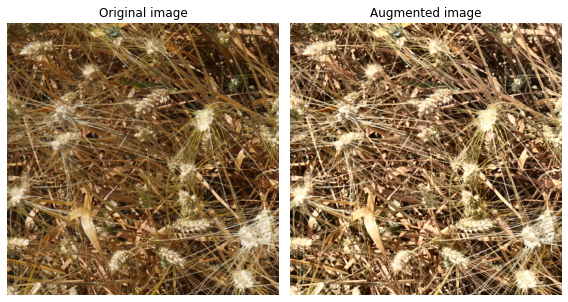

In [ ]:
augment_and_show(clahe, samples)

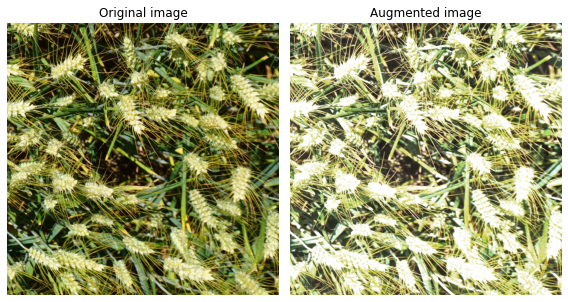

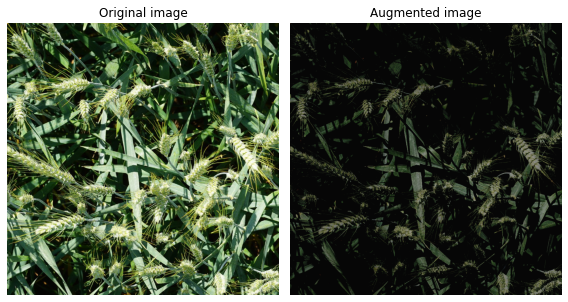

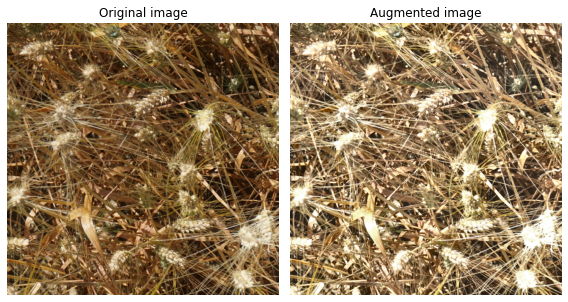

In [ ]:
augment_and_show(light, samples) # あり、もうちょい激しく変化させるか？

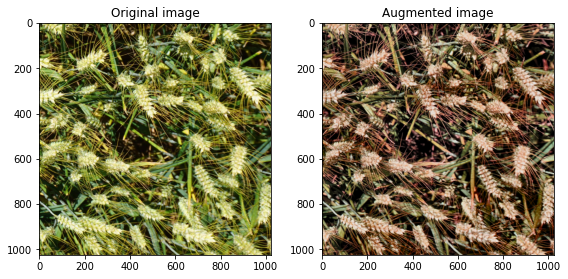

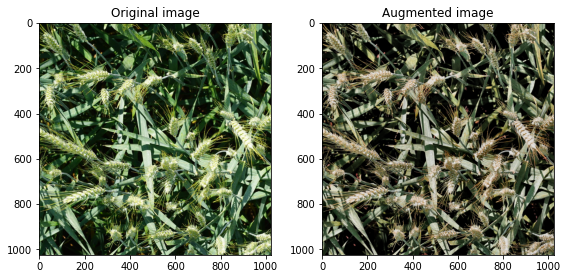

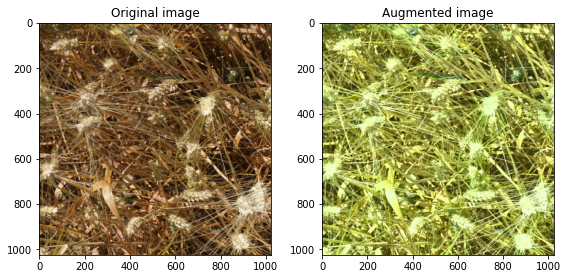

In [ ]:
augment_and_show(medium, samples) # あり、てかもう入ってたっけ？

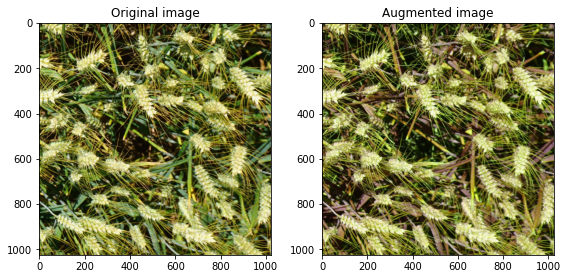

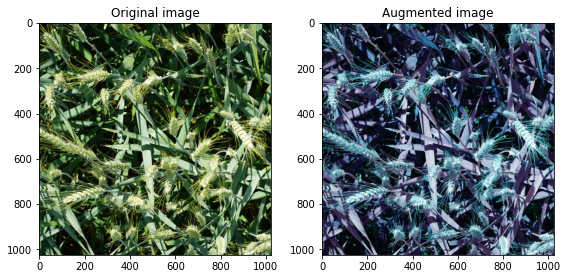

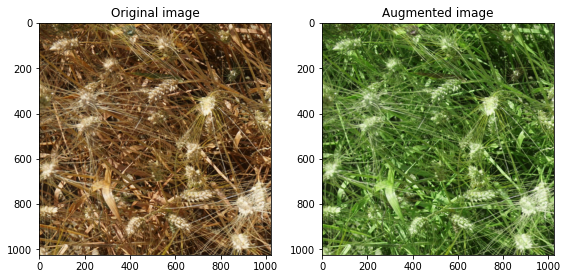

In [ ]:
augment_and_show(strong, samples) # 微妙そうだけど試す価値はあるか？